In [67]:
from pathlib import Path
from data import DATA_DIR

In [68]:
import geopandas as gpd
import pandas as pd
from plotly.subplots import make_subplots
import matplotlib.pyplot as plt

<AxesSubplot:>

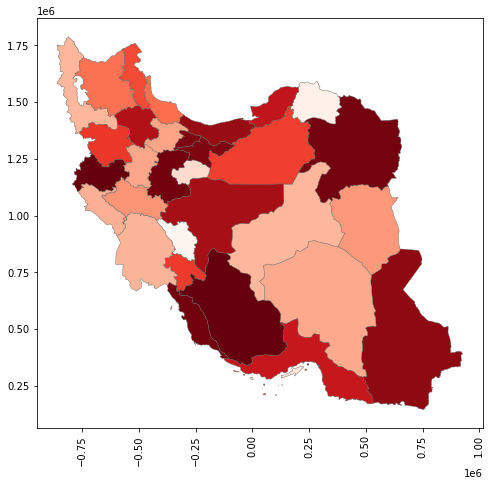

In [104]:
nyc_map = gpd.read_file(DATA_DIR / "os.shp")
stats = pd.read_csv(DATA_DIR / "os.csv")
map_and_stats = nyc_map.merge(stats, on="OBJECTID")

fig, ax = plt.subplots(1, figsize=(8, 8))
plt.xticks(rotation=90)
map_and_stats.plot(column="stat", cmap="Reds", linewidth=0.4, ax=ax, edgecolor=".4")

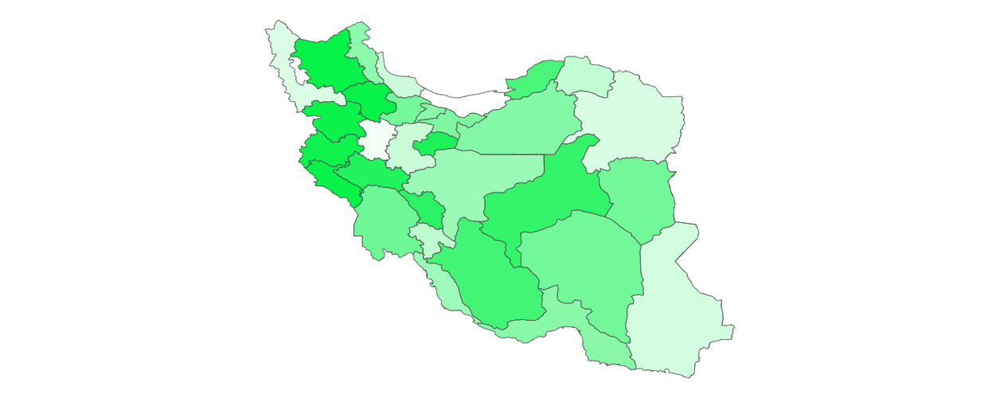

In [2]:
import pandas as pd
import plotly.express as px
import geopandas as gpd
import pyproj
from data import DATA_DIR

nyc_map = gpd.read_file(DATA_DIR / "os.shp")
stats = pd.read_csv(DATA_DIR / "os.csv")

nyc_map.to_crs(pyproj.CRS.from_epsg(4326), inplace=True)
nyc_map.loc[nyc_map.ostn_name =='ÇáÈÑÒ', 'OBJECTID'] = 4
merged = nyc_map.set_index('OBJECTID').join(stats.set_index('OBJECTID'))
merged = merged.reset_index()


fig = px.choropleth(merged, geojson=merged.geometry, locations=merged.OBJECTID, hover_name = 'City',
                    color="Stat", color_continuous_scale =['#ffffff', '#05f248'])

fig.update_geos(fitbounds="locations", visible=False)
fig.update_coloraxes(showscale=False)
fig.update_layout(autosize=False,
          xaxis_title="",
          yaxis_title="",
          width=700, height=500,
          margin=dict(l=0, r=0, b=0, t=0),
          font=dict(
              family="IRANSans",
              size=10,
              color="RebeccaPurple"
          ))

fig.update_layout(
    paper_bgcolor='rgba(0,0,0,0)',
    plot_bgcolor='rgba(0,0,0,0)',
    geo=dict(bgcolor='rgba(0,0,0,0)')
)

fig.show()